In [1]:
import pandas as pd
import os
import re
from pathlib import Path

import matplotlib.font_manager as fm
import matplotlib.pyplot as plt

plt.rcParams["font.family"] = fm.FontProperties(
    fname="/usr/share/fonts/opentype/IBMPlexSansJP-Medium.otf"
).get_name()

from fugashi import Tagger, UnidicFeatures29

tagger = Tagger(f"-d {os.environ['UNIDIC_CWJ_PATH']}")


def tokenize(text: str) -> list[UnidicFeatures29]:
    return [t.feature for t in tagger(text)]

In [2]:
tokenize("こんにちは，世界。")

[UnidicFeatures29(pos1='感動詞', pos2='一般', pos3='*', pos4='*', cType='*', cForm='*', lForm='コンニチハ', lemma='今日は', orth='こんにちは', pron='コンニチワ', orthBase='こんにちは', pronBase='コンニチワ', goshu='混', iType='*', iForm='*', fType='*', fForm='*', iConType='*', fConType='*', type='他', kana='コンニチハ', kanaBase='コンニチハ', form='コンニチハ', formBase='コンニチハ', aType='5', aConType='*', aModType='*', lid='37963946107478528', lemma_id='138112'),
 UnidicFeatures29(pos1='補助記号', pos2='読点', pos3='*', pos4='*', cType='*', cForm='*', lForm='*', lemma='，', orth='，', pron='*', orthBase='，', pronBase='*', goshu='記号', iType='*', iForm='*', fType='*', fForm='*', iConType='*', fConType='*', type='補助', kana='*', kanaBase='*', form='*', formBase='*', aType='*', aConType='*', aModType='*', lid='13752518976000', lemma_id='50'),
 UnidicFeatures29(pos1='名詞', pos2='普通名詞', pos3='一般', pos4='*', cType='*', cForm='*', lForm='セカイ', lemma='世界', orth='世界', pron='セカイ', orthBase='世界', pronBase='セカイ', goshu='漢', iType='セ濁', iForm='基本形', fType='*',

In [3]:
bccwj_filename_map = pd.read_csv("Joined_info.txt", sep="\t").to_dict("records")
bccwj_filename_map = {
    d["サンプルID"]: (d["ジャンル1"], d["ジャンル2"], d["ジャンル3"]) for d in bccwj_filename_map
}
bccwj_filename_map["OT33_00075"]

/tmp/ipykernel_3897832/196930446.py:1: DtypeWarning: Columns (3,4,5,8,13,14,15,16,17,18) have mixed types. Specify dtype option on import or set low_memory=False.
  bccwj_filename_map = pd.read_csv("Joined_info.txt", sep="\t").to_dict("records")


('社会', '高', nan)

In [4]:
corpora = [
    d
    for d in Path("textbook-data").iterdir()
    if d.is_dir() and not str(d).endswith(".git")
]
corpora.append(Path("~/Downloads/検定教科書/").expanduser())
corpora

[PosixPath('textbook-data/Quartet1-article-for-test'),
 PosixPath('textbook-data/Quartet2-article-for-test'),
 PosixPath('textbook-data/ma1-article-for-test'),
 PosixPath('textbook-data/ma2-article-for-test'),
 PosixPath('textbook-data/sinn1-article-for-test'),
 PosixPath('textbook-data/sinn2-article-for-test'),
 PosixPath('/home/bor/Downloads/検定教科書')]

In [5]:
def extract_categeries(s: str) -> str:
    textbook_match = re.search(r"N(\d)-c(\d+)-(.)(\d*)", s)
    if textbook_match:
        return textbook_match.groups()
    else:
        kamoku, school, year = bccwj_filename_map[s.replace(".txt", "")]
        if school == "高":
            level = 10
        elif school == "中":
            level = 6 + int(year)
        else:
            level = int(year)
        return (level, 0, "t")

In [6]:
df = pd.DataFrame.from_records(
    [
        {
            "Textbook": textbook.name,
            "Text": text.name,
            "Level": float(extract_categeries(text.name)[0]),
            "Chapter": int(extract_categeries(text.name)[1]),
            "Category": extract_categeries(text.name)[2],
        }
        | token_features._asdict()
        for textbook in corpora
        for text in textbook.glob("*.txt")
        for token_features in tokenize(text.read_text().replace(" ", ""))
    ],
    index="Text",
)
df = df.fillna("missing")
df

,Textbook,Level,Chapter,Category,pos1,pos2,pos3,pos4,cType,cForm,...,type,kana,kanaBase,form,formBase,aType,aConType,aModType,lid,lemma_id
Text,,,,,,,,,,,,,,,,,,,,,
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,1,r,名詞,固有名詞,地名,国,*,*,...,国,ニッポン,ニッポン,ニッポン,ニッポン,3,*,*,7821659499274752,28455
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,1,r,助詞,格助詞,*,*,*,*,...,格助,ノ,ノ,ノ,ノ,*,名詞%F1,*,7968444268028416,28989
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,1,r,名詞,普通名詞,一般,*,*,*,...,体,アニメ,アニメ,アニメ,アニメ,"1,0",C2,*,248498251506176,904
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,1,r,名詞,普通名詞,一般,*,*,*,...,体,エイガ,エイガ,エイガ,エイガ,"0,1",C2,*,1000839082811904,3641
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,1,r,助詞,格助詞,*,*,*,*,...,格助,ノ,ノ,ノ,ノ,*,名詞%F1,*,7968444268028416,28989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
OT91_00009.txt,検定教科書,1.0,0,t,助動詞,*,*,*,助動詞-タ,連体形-一般,...,助動,タ,タ,タ,タ,*,"動詞%F2@1,形容詞%F4@-2",*,5948916285711041,21642
OT91_00009.txt,検定教科書,1.0,0,t,助詞,準体助詞,*,*,*,*,...,準助,ン,ン,ン,ン,*,"動詞%F2@0,形容詞%F2@-1",*,7968727735869952,28990
OT91_00009.txt,検定教科書,1.0,0,t,助動詞,*,*,*,助動詞-ダ,終止形-一般,...,助動,ダ,ダ,ダ,ダ,*,名詞%F1,*,6299110739157675,22916


In [7]:
from collections import Counter

Counter(df["goshu"])

Counter({'固': 24094,
         '和': 636193,
         '外': 27203,
         '漢': 305411,
         '記号': 199127,
         'missing': 4729,
         '混': 7009})

In [8]:
g = ["Textbook"]
c = "goshu"

In [9]:
textbook_n = df.groupby(g).size()
textbook_n

Textbook
Quartet1-article-for-test      11941
Quartet2-article-for-test      17326
ma1-article-for-test            9108
ma2-article-for-test           15847
sinn1-article-for-test         10448
sinn2-article-for-test         14097
検定教科書                        1124999
dtype: int64

In [10]:
textbook_pos = df.groupby(g + [c]).size()
textbook_pos

Textbook                   goshu  
Quartet1-article-for-test  missing        65
                           和            7662
                           固             247
                           外             332
                           混              97
                           漢            1762
                           記号           1776
Quartet2-article-for-test  missing       339
                           和           11419
                           固             282
                           外             372
                           混             160
                           漢            3055
                           記号           1699
ma1-article-for-test       missing        37
                           和            6092
                           固             332
                           外             231
                           混              59
                           漢            1295
                           記号           1062
ma2-article-for-test

In [11]:
textbook_pos.index.get_level_values(c)

Index(['missing', '和', '固', '外', '混', '漢', '記号', 'missing', '和', '固', '外', '混',
       '漢', '記号', 'missing', '和', '固', '外', '混', '漢', '記号', 'missing', '和',
       '固', '外', '混', '漢', '記号', 'missing', '和', '固', '外', '混', '漢', '記号',
       'missing', '和', '固', '外', '混', '漢', '記号', 'missing', '和', '固', '外', '混',
       '漢', '記号'],
      dtype='object', name='goshu')

In [12]:
normalized_counts = textbook_pos.div(textbook_n, level=g[0]).reset_index(
    name="normalized_count"
)
normalized_counts

,Textbook,goshu,normalized_count
0,Quartet1-article-for-test,missing,0.005443
1,Quartet1-article-for-test,和,0.641655
2,Quartet1-article-for-test,固,0.020685
3,Quartet1-article-for-test,外,0.027803
4,Quartet1-article-for-test,混,0.008123
5,Quartet1-article-for-test,漢,0.147559
6,Quartet1-article-for-test,記号,0.148731
7,Quartet2-article-for-test,missing,0.019566
8,Quartet2-article-for-test,和,0.659067
9,Quartet2-article-for-test,固,0.016276


In [13]:
normalized_counts.pivot(index=g[0], columns=c)

normalized_count                                \
goshu                              missing         和         固         外   
Textbook                                                                   
Quartet1-article-for-test         0.005443  0.641655  0.020685  0.027803   
Quartet2-article-for-test         0.019566  0.659067  0.016276  0.021471   
ma1-article-for-test              0.004062  0.668863  0.036451  0.025362   
ma2-article-for-test              0.002461  0.716413  0.029091  0.019310   
sinn1-article-for-test            0.058959  0.586237  0.037041  0.021440   
sinn2-article-for-test            0.055969  0.597858  0.039725  0.025963   
検定教科書                             0.002528  0.520102  0.019400  0.022553   

                                                         
goshu                             混         漢        記号  
Textbook                                                 
Quartet1-article-for-test  0.008123  0.147559  0.148731  
Quartet2-article-for-test  0.009235  0.176325  0.098061  
ma1-article-for-test       0.006478  0.142183  0.116601  
ma2-article-for-test       0.006752  0.131697  0.094277  
sinn1-article-for-test     0.008614  0.172186  0.115525  
sinn2-article-for-test     0.006384  0.177910  0.096191  
検定教科書                      0.005694  0.260360  0.169363

<Axes: xlabel='Textbook'>

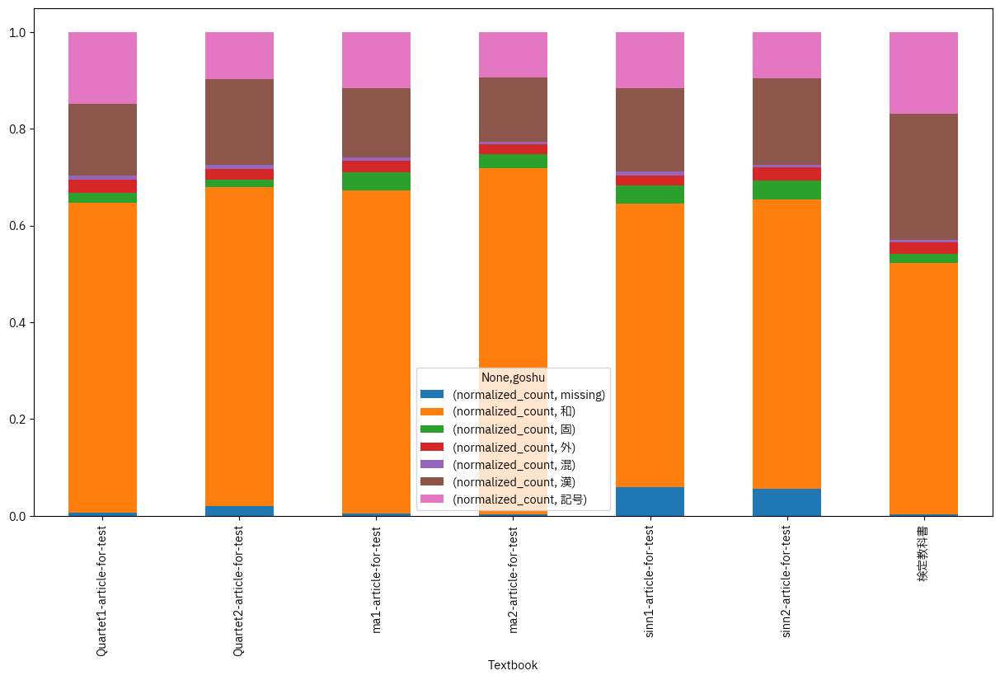

In [23]:
normalized_counts.pivot(index=g[0], columns=c).plot(
    kind="bar",
    stacked=True,
    figsize=(15, 8),
)

In [31]:
m_df = pd.melt(
    df, id_vars=["Textbook", "Level"], value_vars=["goshu"], ignore_index=False
)
m_df

,Textbook,Level,variable,value
Text,,,,
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,goshu,固
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,goshu,和
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,goshu,外
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,goshu,漢
N3-c1-r1-アニメ映画監督宮崎駿.txt,Quartet1-article-for-test,3.0,goshu,和
...,...,...,...,...
OT91_00009.txt,検定教科書,1.0,goshu,和
OT91_00009.txt,検定教科書,1.0,goshu,和
OT91_00009.txt,検定教科書,1.0,goshu,和


In [49]:
import plotly.express as px

fig = px.histogram(df, x="goshu", color="Textbook", barmode="group", histnorm="percent")
fig.update_yaxes(matches=None)